In [1]:
# this file is kind of repetitive but it has the same stuff we were doing with the real data

import pandas as pd
import numpy as np
from dotenv import dotenv_values, find_dotenv
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import ListedColormap
from datacleaning.functions import filter_by_granularity
from statsmodels.tsa.api import VAR
# from statsmodels.tsa.stattools import adfuller
# from statsmodels.tools.eval_measures import rmse, aic
import os
config = dotenv_values(find_dotenv())
path_rawdata = os.path.abspath(config["RAWDATA"]) + '\\'
path_cleandata = os.path.abspath(config["CLEANDATA"]) + '\\'
path_figures = os.path.abspath(config["FIGURES"]) + '\\'

# for plots
plt.rcParams.update({'font.size': 25})

In [4]:
# choose one date per decade for the troubleshooting plots (maybe just the fifth year, July 31 per decade since its the middle of the year ish)
plotdates = [dt.datetime(1965,7,31), dt.datetime(1975,7,31), dt.datetime(1985,7,31), dt.datetime(1995,7,31), dt.datetime(2005,7,31), dt.datetime(2015,7,31)]

# import fake data
montecarlo_prices = pd.read_pickle(path_cleandata + 'montecarlogenerated\\prices.pkl')
montecarlo_sales = pd.read_pickle(path_cleandata + 'montecarlogenerated\\sales.pkl')
# all products and all dates
products_to_include = list(set(montecarlo_prices['product']))
dates = list(set(montecarlo_prices['date']))

# prepare original data to run VARS
bea_products = pd.read_pickle(path_cleandata + 'BEA_PCE.pkl')
beadata = filter_by_granularity(bea_products, target_granularity=6)
beadata = beadata[beadata['product'].isin(products_to_include)]
beadata = beadata[beadata['date'].isin(dates)]

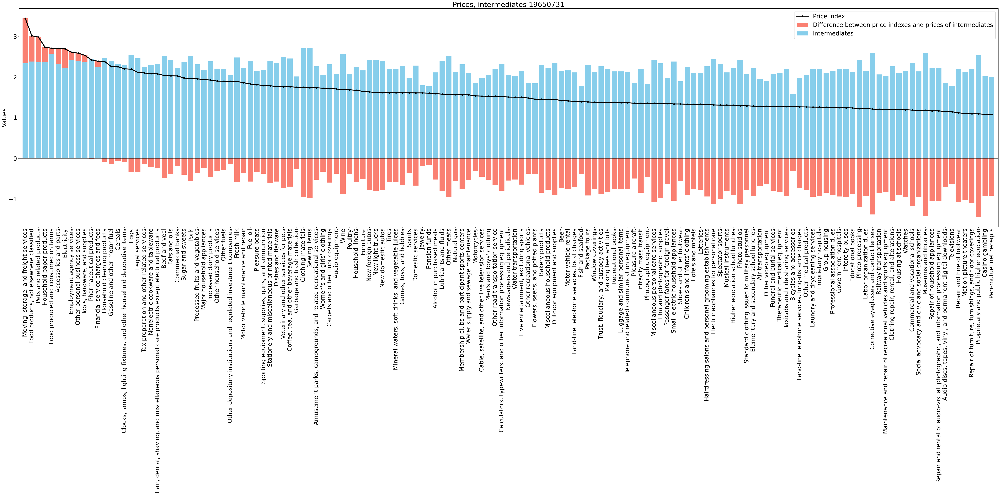

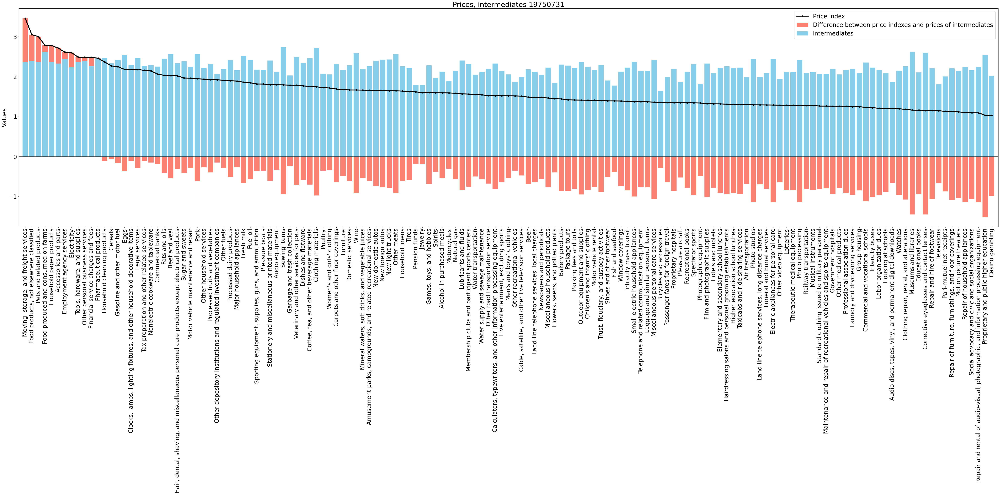

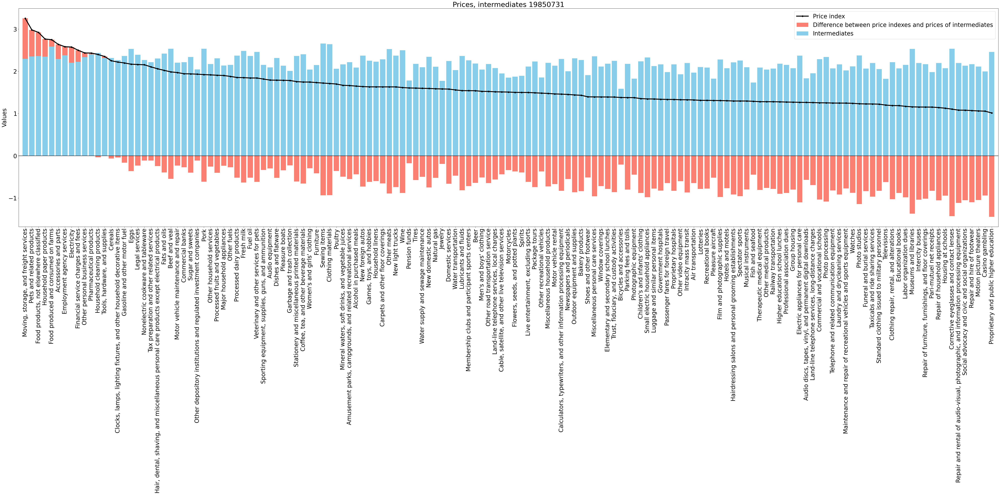

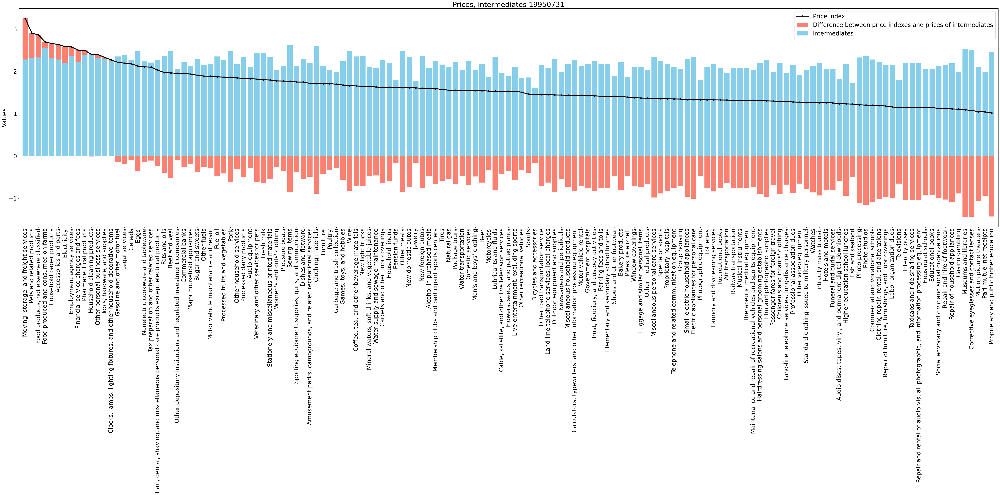

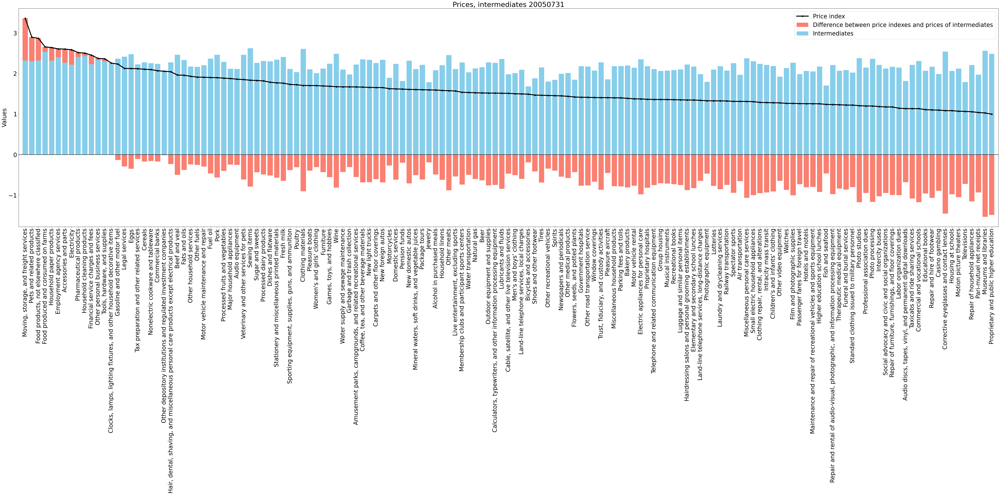

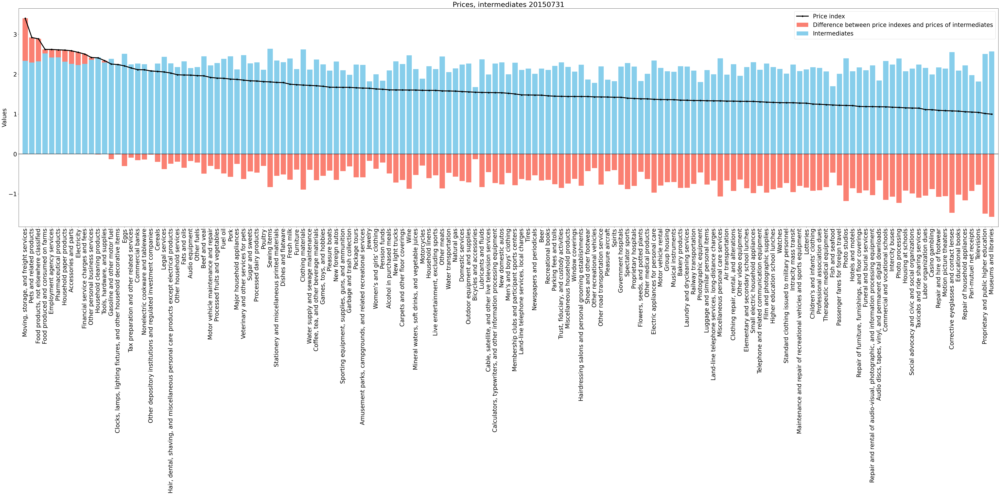

In [5]:
# intermediates vs prices (plot, non-log scale)
compare = montecarlo_prices[['date', 'product', 'intermediates', 'priceindex']].sort_values(['date', 'priceindex'], ascending=False)

for idx, date in enumerate(plotdates):
    toplot_date = compare[compare['date'] == date].set_index('product')
    products = toplot_date.index
    price = toplot_date['priceindex']
    intermediates_forplot = toplot_date['intermediates']
    diff = price - intermediates_forplot

    datestr = date.strftime("%Y/%m/%d").replace('/', '')

    # plots for price residuals

    # calculate heights for stacked bars
    positive_diff = np.where((diff >= 0) & (intermediates_forplot >= 0), diff, 0)
    positive_adjusted = np.where((diff >= 0) & (intermediates_forplot >= 0), intermediates_forplot, intermediates_forplot)
    negative_diff = np.where((diff < 0) & (intermediates_forplot < 0), diff, 0)
    negative_adjusted = np.where((diff < 0) & (intermediates_forplot < 0), intermediates_forplot, intermediates_forplot)

    # open figure
    fig, ax = plt.subplots(figsize=(60, 30))

    ax.axhline(y=0, color='black')

    # layering bars for the right display
    ax.bar(products, diff, color='salmon', label='Difference between price indexes and prices of intermediates')
    ax.bar(products, positive_adjusted, color='skyblue', label='Intermediates')
    ax.bar(products, positive_diff, color='salmon', bottom=positive_adjusted, label='_')
    ax.bar(products, negative_adjusted, color='skyblue', label='_')
    ax.bar(products, negative_diff, color='salmon', bottom=negative_adjusted, label='_')

    line, = ax.plot(products, price, linestyle='-', marker='o', color='black', linewidth=4, label='Price index')
    
    # set appearances
    ax.set_title('Prices, intermediates ' + datestr)
    ax.legend(loc='upper right')
    ax.set_ylabel('Values')
    ax.set_xticks(np.arange(len(products))) 
    ax.set_xticklabels(products, rotation=90)
    ax.set_xlim(-1, len(products))
    fig.tight_layout()

    plt.savefig(path_figures + 'montecarloprices\\montecarlo_intermediates_' + datestr + '.pdf', bbox_inches='tight')

    plt.show()

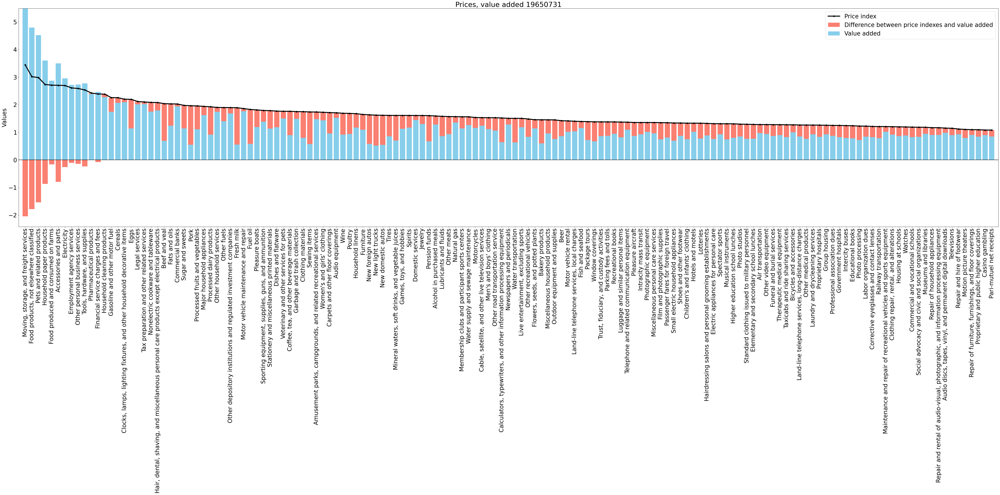

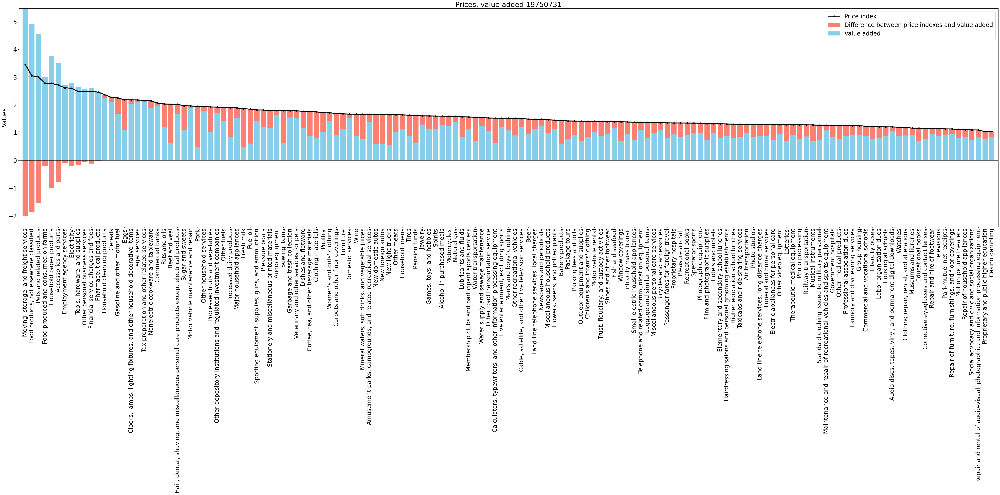

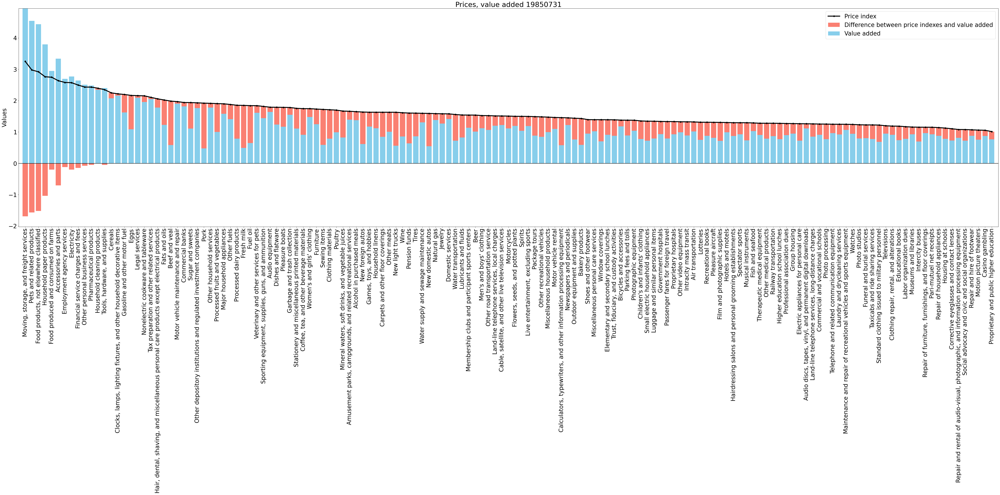

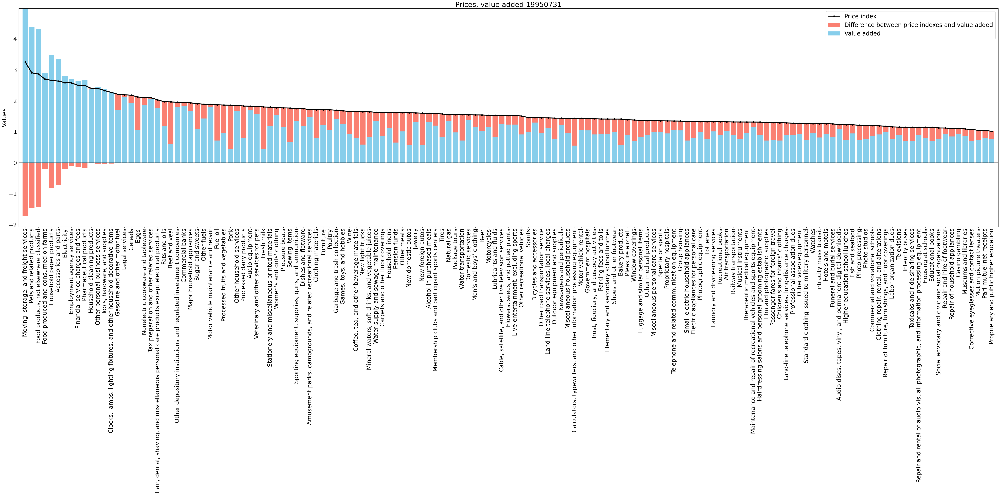

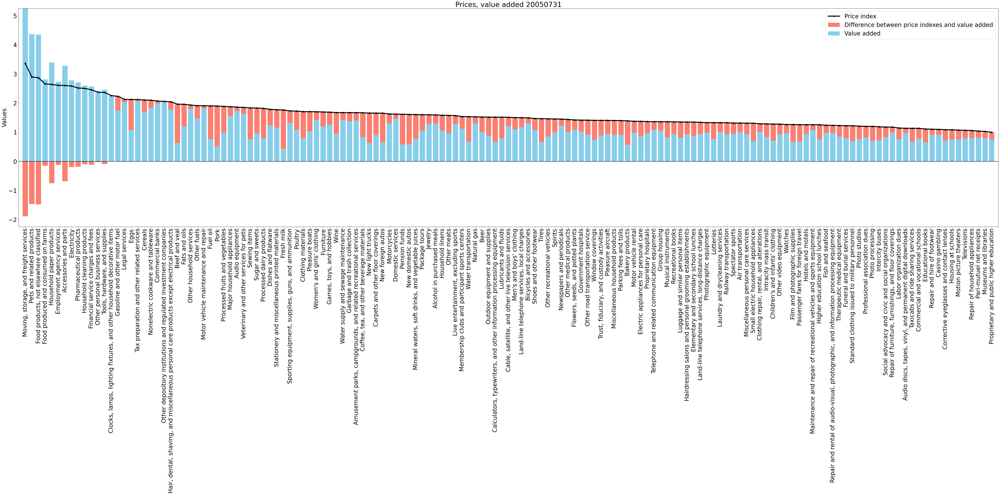

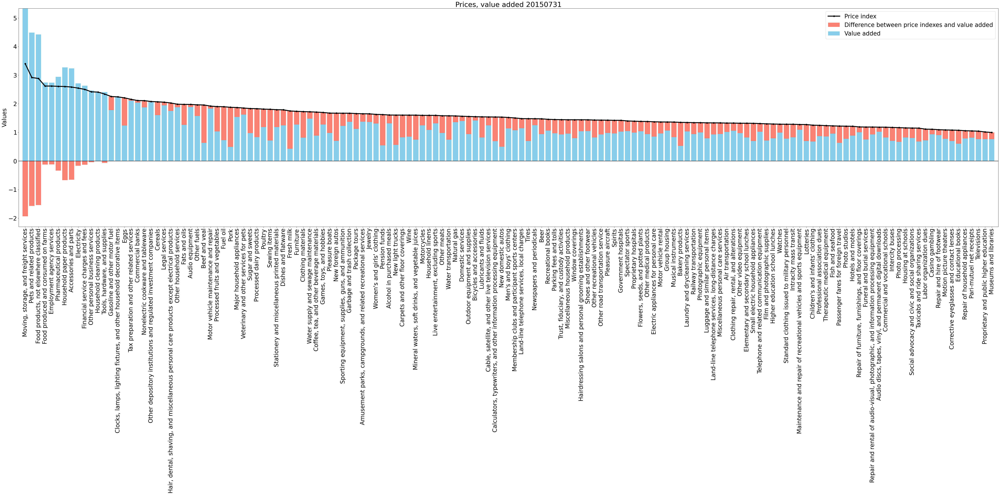

In [6]:
compare = montecarlo_prices[['date', 'product', 'value_added', 'priceindex']].sort_values(['date', 'priceindex'], ascending=False)

for idx, date in enumerate(plotdates):
    toplot_date = compare[compare['date'] == date].set_index('product')
    products = toplot_date.index
    price = toplot_date['priceindex']
    value_added_forplot = toplot_date['value_added']
    diff = price - value_added_forplot

    datestr = date.strftime("%Y/%m/%d").replace('/', '')

    # plots for price residuals

    # calculate heights for stacked bars
    positive_diff = np.where((diff >= 0) & (value_added_forplot >= 0), diff, 0)
    positive_adjusted = np.where((diff >= 0) & (value_added_forplot >= 0), value_added_forplot, value_added_forplot)
    negative_diff = np.where((diff < 0) & (value_added_forplot < 0), diff, 0)
    negative_adjusted = np.where((diff < 0) & (value_added_forplot < 0), value_added_forplot, value_added_forplot)

    # open figure
    fig, ax = plt.subplots(figsize=(60, 30))

    ax.axhline(y=0, color='black')

    # layering bars for the right display
    ax.bar(products, diff, color='salmon', label='Difference between price indexes and value added')
    ax.bar(products, positive_adjusted, color='skyblue', label='Value added')
    ax.bar(products, positive_diff, color='salmon', bottom=positive_adjusted, label='_')
    ax.bar(products, negative_adjusted, color='skyblue', label='_')
    ax.bar(products, negative_diff, color='salmon', bottom=negative_adjusted, label='_')

    line, = ax.plot(products, price, linestyle='-', marker='o', color='black', linewidth=4, label='Price index')
    
    # set appearances
    ax.set_title('Prices, value added ' + datestr)
    ax.legend(loc='upper right')
    ax.set_ylabel('Values')
    ax.set_xticks(np.arange(len(products))) 
    ax.set_xticklabels(products, rotation=90)
    ax.set_xlim(-1, len(products))
    fig.tight_layout()

    plt.savefig(path_figures + 'montecarloprices\\montecarlo_valueadded_' + datestr + '.pdf', bbox_inches='tight')

    plt.show()

In [7]:
# run vars, get resid

# use the list of I products
lags = 8
residuals = pd.DataFrame(columns=['date', 'product', 'resid_price', 'resid_quantity', 'resid_valueadded', 'resid_sales'])

for product in products_to_include:
    # filter for product
    original = beadata[beadata['product'] == product][['date', 'priceindex', 'quantityindex']].sort_values(['date'])
    calculated = pd.merge(left=montecarlo_prices[['date', 'product', 'value_added']], right=montecarlo_sales, on=['product', 'date'], how='inner')
    calculated = calculated[calculated['product'] == product][['date', 'value_added', 'sales']].sort_values(['date'])
    # datetimeindex
    original = original.set_index('date')
    calculated = calculated.set_index('date')

    # using first differences
    original['priceindex'] = np.log(original['priceindex']).diff()
    original['quantityindex'] = np.log(original['quantityindex']).diff()
    calculated['value_added'] = np.log(calculated['value_added']).diff()
    calculated['sales'] = np.log(calculated['sales']).diff()
    # drop nans for model
    original.dropna(inplace=True)
    calculated.dropna(inplace=True)

    # fit
    model_original = VAR(original.asfreq('Q-OCT'))
    result_original = model_original.fit(lags)
    model_calculated = VAR(calculated.asfreq('Q-OCT'))
    result_calculated = model_calculated.fit(lags)

    # print(product)
    # print('AIC : ', result.aic)
    # print('BIC : ', result.bic)
    # print('FPE : ', result.fpe)
    # print('HQIC: ', result.hqic)

    # residuals
    residuals_original = result_original.resid.reset_index()
    residuals_original['product'] = product
    residuals_original.rename(columns={'priceindex': 'resid_price', 'quantityindex': 'resid_quantity'}, inplace=True)
    residuals = pd.merge(left=residuals, right=residuals_original, on=['date', 'product', 'resid_price', 'resid_quantity'], how='outer')

    residuals_calculated = result_calculated.resid.reset_index()
    residuals_calculated['product'] = product
    residuals_calculated.rename(columns={'value_added': 'resid_valueadded', 'sales': 'resid_sales'}, inplace=True)
    residuals = pd.merge(left=residuals, right=residuals_calculated, on=['date', 'product', 'resid_valueadded', 'resid_sales'], how='outer')

# save
residuals = residuals.groupby(['date', 'product']).sum(min_count=1).reset_index()
residuals = residuals.sort_values(['date', 'product'])
residuals.to_pickle(path_cleandata + 'montecarlogenerated//residuals.pkl')


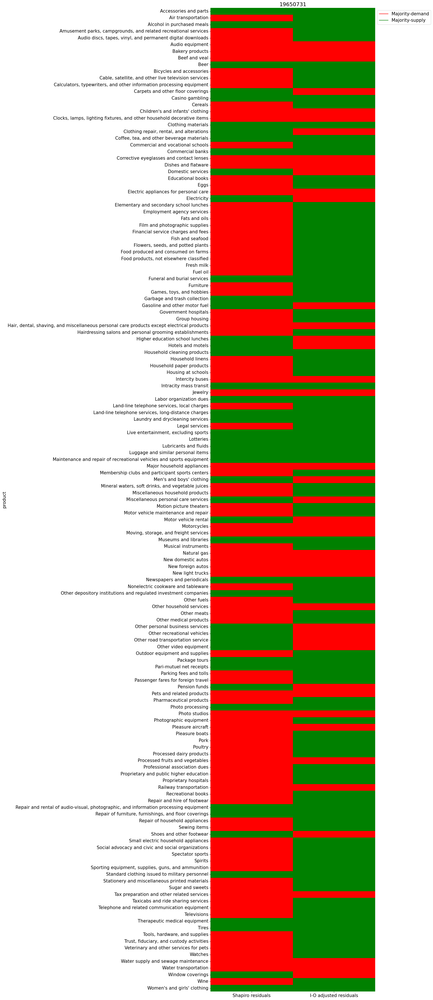

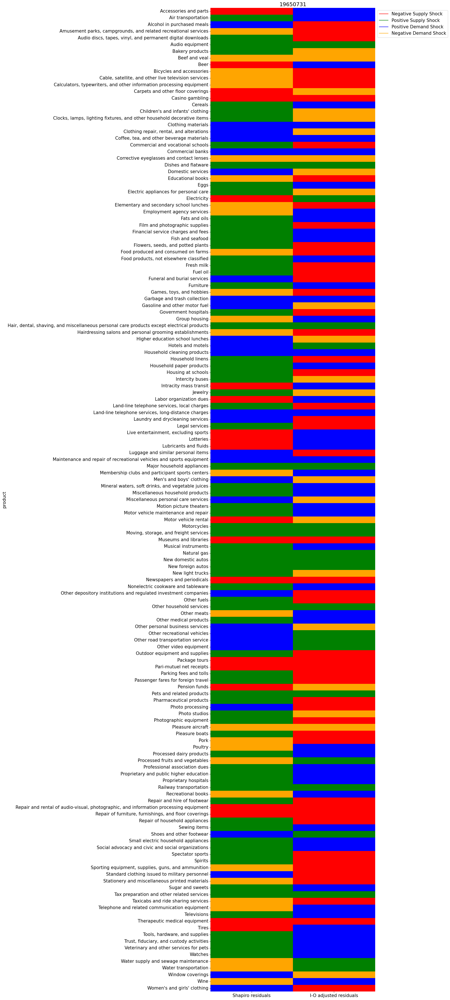

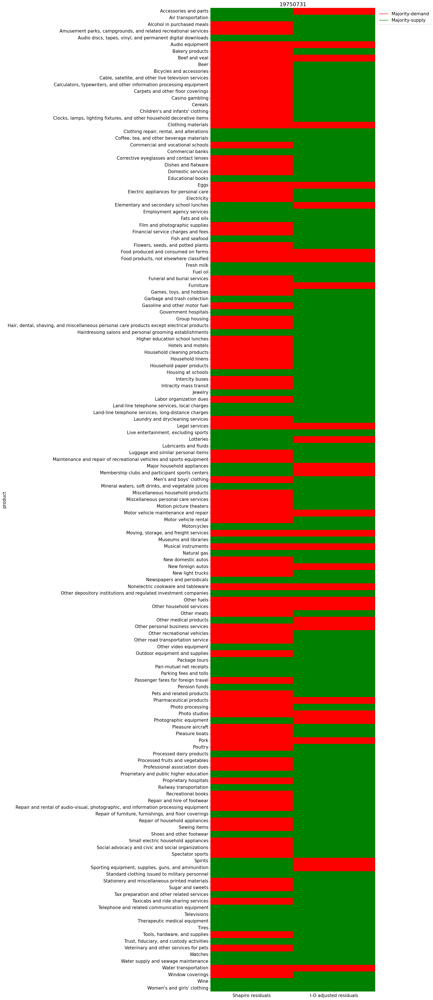

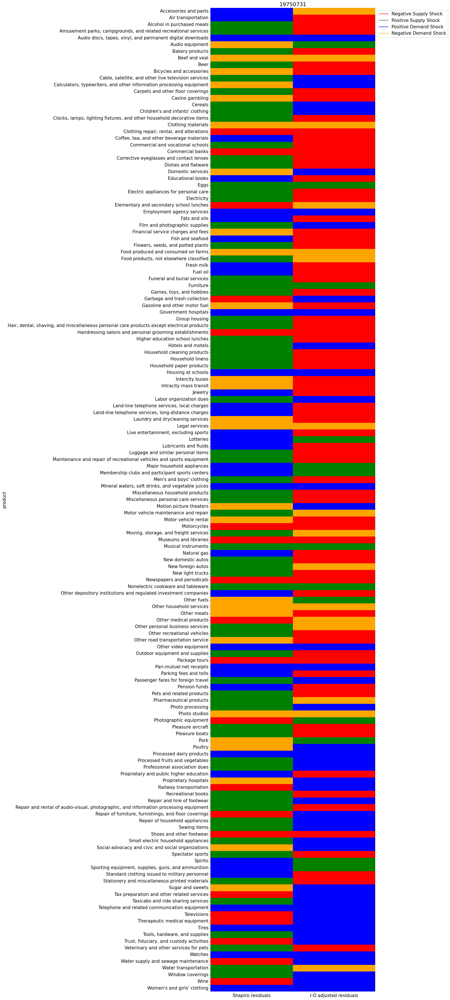

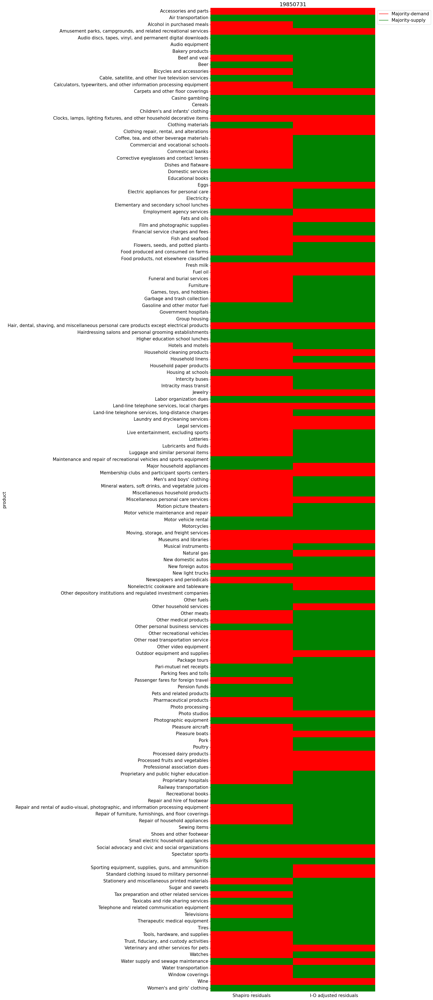

...

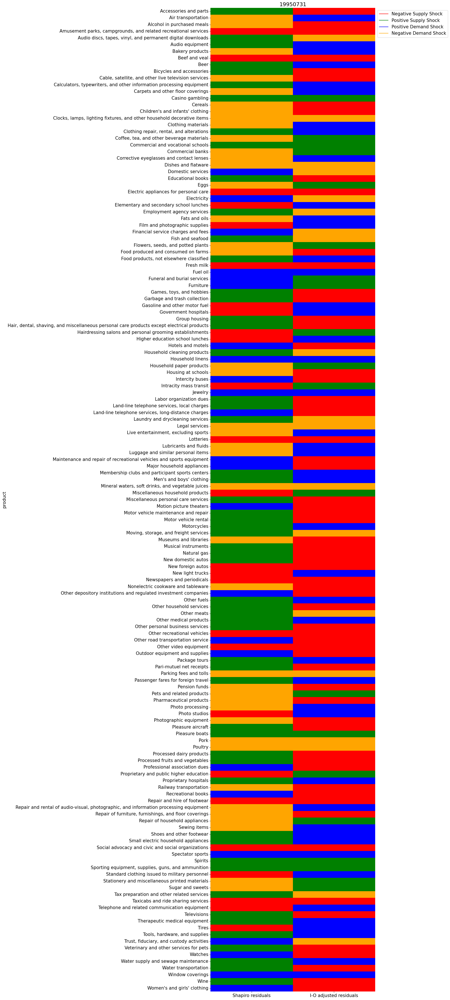

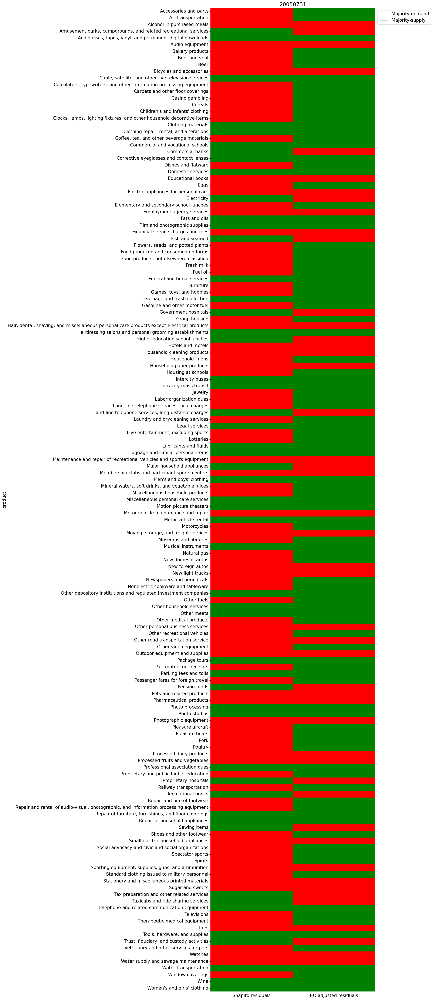

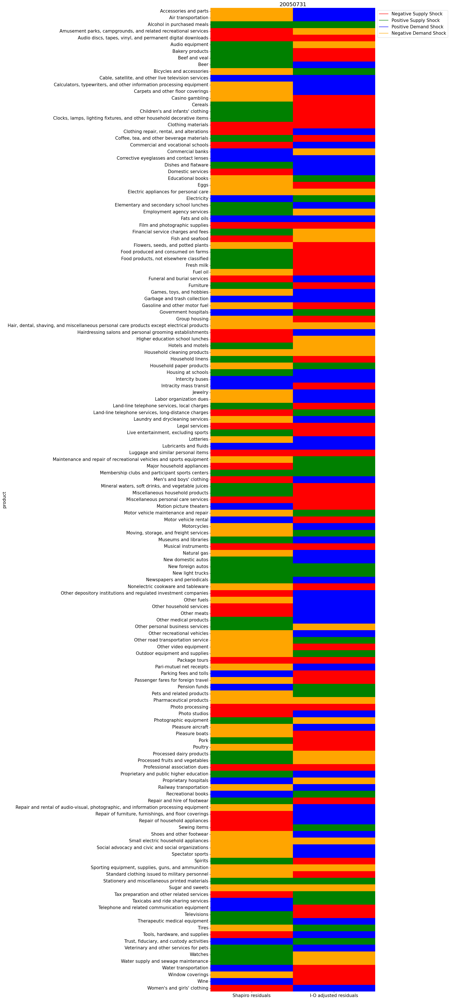

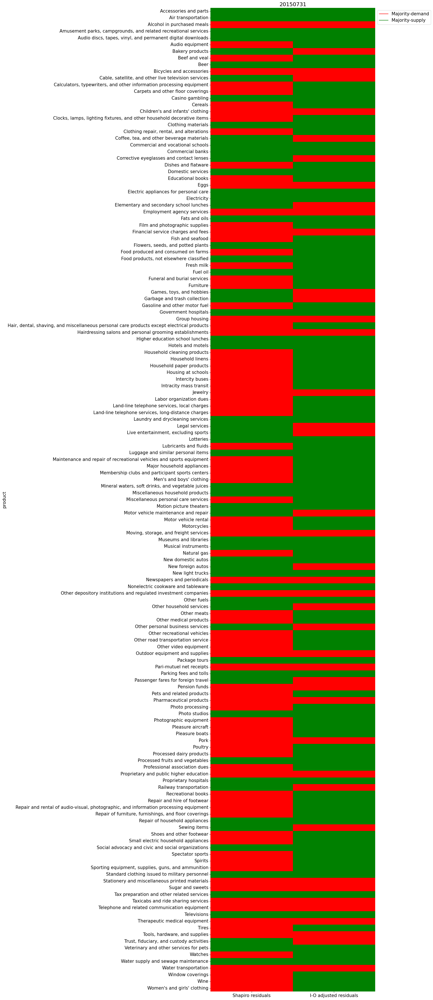

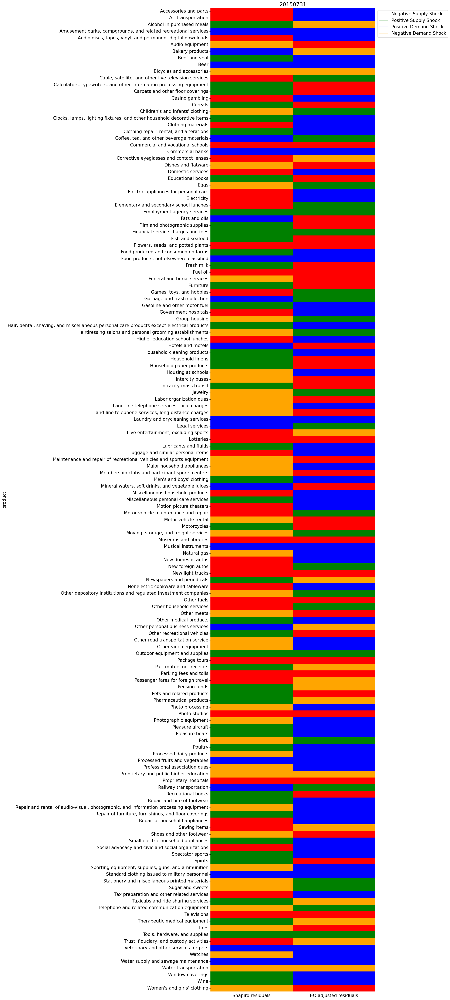

In [8]:
# classifications

# supply vs demand driven
residuals['majority_demand'] = ((residuals['resid_price'] * residuals['resid_quantity']) >= 0).astype(int)
residuals['majority_supply'] = ((residuals['resid_price'] * residuals['resid_quantity']) < 0).astype(int)
# further types of shocks
residuals['type'] = 'negative_supply'
residuals.loc[(residuals['resid_price'] >= 0) & (residuals['resid_quantity'] < 0), 'type'] = 'positive_supply'
residuals.loc[(residuals['resid_price'] >= 0) & (residuals['resid_quantity'] >= 0), 'type'] = 'positive_demand'
residuals.loc[(residuals['resid_price'] < 0) & (residuals['resid_quantity'] < 0), 'type'] = 'negative_demand'

# supply vs demand driven
residuals['majority_demand_a'] = ((residuals['resid_valueadded'] * residuals['resid_sales']) >= 0).astype(int)
residuals['majority_supply_a'] = ((residuals['resid_valueadded'] * residuals['resid_sales']) < 0).astype(int)
# further types of shocks
residuals['type_a'] = 'negative_supply'
residuals.loc[(residuals['resid_valueadded'] >= 0) & (residuals['resid_sales'] < 0), 'type_a'] = 'positive_supply'
residuals.loc[(residuals['resid_valueadded'] >= 0) & (residuals['resid_sales'] >= 0), 'type_a'] = 'positive_demand'
residuals.loc[(residuals['resid_valueadded'] < 0) & (residuals['resid_sales'] < 0), 'type_a'] = 'negative_demand'

# data for heatmaps
classification_toplot = residuals[residuals['date'].isin(dates)][['date', 'product', 'majority_demand', 'majority_demand_a', 'type', 'type_a']].sort_values(['date', 'product'])

# heatmaps

plt.rcParams.update({'font.size': 15})

for idx, date in enumerate(plotdates):
    classification_toplot_date = classification_toplot[classification_toplot['date'] == date].copy()

    datestr = date.strftime("%Y/%m/%d").replace('/', '')

    # supply/demand

    colors = ['red', 'green']
    cmap = ListedColormap(colors)

    plt.figure(figsize=(10, 60))
    heatmap = sns.heatmap(classification_toplot_date[['product', 'majority_demand', 'majority_demand_a']].set_index('product'), cmap=['red', 'green'], cbar=False, annot=False, fmt='d')
    
    # labelling
    plt.title(datestr)
    heatmap.set_xticklabels(['Shapiro residuals', 'I-O adjusted residuals'])
    # legend
    legend_labels = {
        0: 'Majority-demand',
        1: 'Majority-supply'
    }
    for key, value in legend_labels.items():
        plt.plot([], [], color=colors[key], label=value)
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

    plt.savefig(path_figures + 'montecarloshocks//montecarloclassifications_supplydemand_' + datestr + '.pdf', bbox_inches='tight')
    plt.show()

    # positive/negative supply/demand

    # encoding
    classification_toplot_date.loc[:, 'type_code'] = pd.Categorical(classification_toplot_date['type']).codes
    classification_toplot_date.loc[:, 'type_a_code'] = pd.Categorical(classification_toplot_date['type_a']).codes

    colors = ['red', 'green', 'blue', 'orange']
    cmap = ListedColormap(colors)

    # open figure
    plt.figure(figsize=(10, 60))
    heatmap = sns.heatmap(classification_toplot_date[['product', 'type_code', 'type_a_code']].set_index('product'), 
                cmap=cmap, cbar=False, annot=False)
    
    # labelling
    plt.title(datestr)
    heatmap.set_xticklabels(['Shapiro residuals', 'I-O adjusted residuals'])
    # legend
    legend_labels = {
        0: 'Negative Supply Shock',
        1: 'Positive Supply Shock',
        2: 'Positive Demand Shock',
        3: 'Negative Demand Shock'
    }
    for key, value in legend_labels.items():
        plt.plot([], [], color=colors[key], label=value)
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))


    plt.savefig(path_figures + 'montecarloshocks//montecarloclassifications_positivenegative_' + datestr + '.pdf', bbox_inches='tight')
    plt.show()